<a href="https://colab.research.google.com/github/Sandanu87/Nextgen-Analytics-Modified-/blob/main/PreProcessing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
#Importing relevant libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
#Uploading files
from google.colab import files
data = files.upload()

Saving traincsv.csv to traincsv.csv


In [4]:
#Loading data into a pandas dataframe
data = pd.read_csv('traincsv.csv', low_memory=False)

In [5]:
#Displaying first five rows
data.head()

,Customer_ID,outlet_city,luxury_sales,fresh_sales,dry_sales,cluster_catgeory
0,10493832.0,Kelaniya,1209.6,756,5292,4
1,10178643.0,Moratuwa,1590.12,1060.08,6007.12,1
2,10513916.0,Wattala,2288.88,1481.04,9155.52,4
3,10334589.0,Wattala,2274.94,1739.66,9099.76,4
4,10458365.0,Kelaniya,2345.49,2069.55,9243.99,4


In [6]:
#Generating descriptive statistics
data.describe(include='all')

,Customer_ID,outlet_city,luxury_sales,fresh_sales,dry_sales,cluster_catgeory
count,7.741530e+05,774153,774120,774114,774125,774154
unique,NaN,20,143897,199311,195870,12
top,NaN,Colombo,1029.6,1071,1915.2,1
freq,NaN,41031,62,30,28,188984
mean,1.038708e+07,NaN,NaN,NaN,NaN,NaN
std,2.234795e+05,NaN,NaN,NaN,NaN,NaN
min,1.000000e+07,NaN,NaN,NaN,NaN,NaN
25%,1.019354e+07,NaN,NaN,NaN,NaN,NaN
50%,1.038708e+07,NaN,NaN,NaN,NaN,NaN
75%,1.058062e+07,NaN,NaN,NaN,NaN,NaN


In [7]:
#Generating dataset dimensions
data.shape

(774155, 6)

In [8]:
#Generating dataframe columns
data.columns

Index(['Customer_ID', 'outlet_city', 'luxury_sales', 'fresh_sales',
       'dry_sales', 'cluster_catgeory'],
      dtype='object')

In [9]:
#Examining the data structure
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 774155 entries, 0 to 774154
Data columns (total 6 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Customer_ID       774153 non-null  float64
 1   outlet_city       774153 non-null  object 
 2   luxury_sales      774120 non-null  object 
 3   fresh_sales       774114 non-null  object 
 4   dry_sales         774125 non-null  object 
 5   cluster_catgeory  774154 non-null  object 
dtypes: float64(1), object(5)
memory usage: 35.4+ MB


In [10]:
#Examining duplicate data
data['Customer_ID'].duplicated().sum()

np.int64(1)

In [11]:
data.duplicated().sum()

np.int64(0)

In [12]:
#Examining number of unique data in customer id column
data['Customer_ID'].nunique()

774153

In [13]:
#Examining number of unique data in cluster_catgeory column
data['cluster_catgeory'].nunique()

12

In [14]:
#Checking the null values
data.isnull().sum()

,0
Customer_ID,2
outlet_city,2
luxury_sales,35
fresh_sales,41
dry_sales,30
cluster_catgeory,1


In [15]:
#Dropping duplicate data in Customer_ID
data.drop_duplicates(subset='Customer_ID', inplace=True, keep='first')

In [16]:
#Dropping missing values
data.dropna(subset=['Customer_ID'], inplace=True)

In [17]:
data.isnull().sum()

,0
Customer_ID,0
outlet_city,2
luxury_sales,35
fresh_sales,41
dry_sales,30
cluster_catgeory,1


In [18]:
#Filling the missing data using random sampling imputation
data['outlet_city'] = data['outlet_city'].replace(['', ' ', '-', 'N/A'], np.nan)

non_missing_values = data['outlet_city'].dropna()
data['outlet_city'] = data['outlet_city'].fillna(pd.Series(np.random.choice(non_missing_values, size=data['outlet_city'].isnull().sum()), index=data.loc[data['outlet_city'].isnull()].index))

In [19]:
data.isnull().sum()

,0
Customer_ID,0
outlet_city,0
luxury_sales,35
fresh_sales,41
dry_sales,30
cluster_catgeory,1


In [20]:
#Converting sales columns to numeric values
str_columns = ['luxury_sales','fresh_sales','dry_sales']

for column in str_columns:
    data[column] = pd.to_numeric(data[column], errors='coerce')

In [21]:
#Describing data after changing data types
data.describe()

,Customer_ID,luxury_sales,fresh_sales,dry_sales
count,7.741530e+05,774108.000000,774103.000000,774115.000000
mean,1.038708e+07,1921.967004,4428.686701,4676.276397
std,2.234795e+05,1004.078975,3334.656202,3409.388418
min,1.000000e+07,500.000000,500.000000,500.000000
25%,1.019354e+07,1213.530000,1620.190000,1787.940000
50%,1.038708e+07,1715.280000,3356.540000,3727.760000
75%,1.058062e+07,2338.700000,6671.610000,7162.200000
max,1.077415e+07,6999.650000,13997.900000,13999.300000


In [22]:
#Examining the data types
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 774153 entries, 0 to 774154
Data columns (total 6 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Customer_ID       774153 non-null  float64
 1   outlet_city       774153 non-null  object 
 2   luxury_sales      774108 non-null  float64
 3   fresh_sales       774103 non-null  float64
 4   dry_sales         774115 non-null  float64
 5   cluster_catgeory  774152 non-null  object 
dtypes: float64(4), object(2)
memory usage: 41.3+ MB


<Axes: >

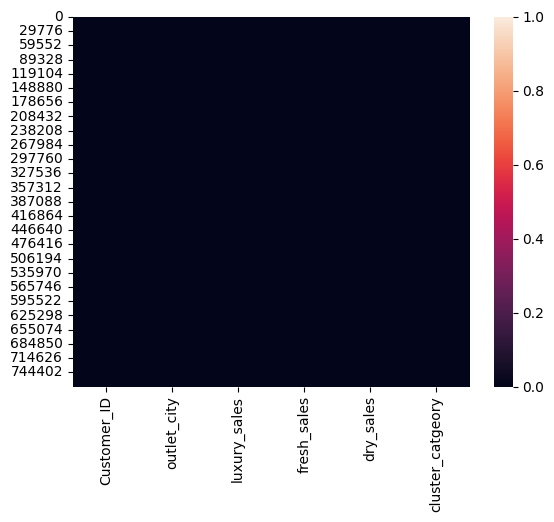

In [23]:
#Missing data via heatmap
cols = data.columns
sns.heatmap(data[cols].isnull())

In [24]:
#Handling missing values in sales column
from sklearn.impute import KNNImputer
sales_columns = ['luxury_sales', 'fresh_sales', 'dry_sales']
imputer = KNNImputer(n_neighbors=5)
data[sales_columns] = imputer.fit_transform(data[sales_columns])

In [25]:
data.isnull().sum()

,0
Customer_ID,0
outlet_city,0
luxury_sales,0
fresh_sales,0
dry_sales,0
cluster_catgeory,1


In [26]:
#Checking if the missing values has been handled
data.describe()

,Customer_ID,luxury_sales,fresh_sales,dry_sales
count,7.741530e+05,774153.000000,774153.000000,774153.000000
mean,1.038708e+07,1921.989281,4428.682510,4676.298074
std,2.234795e+05,1004.102803,3334.631276,3409.412972
min,1.000000e+07,500.000000,500.000000,500.000000
25%,1.019354e+07,1213.530000,1620.190000,1787.940000
50%,1.038708e+07,1715.300000,3356.600000,3727.760000
75%,1.058062e+07,2338.700000,6671.600000,7162.200000
max,1.077415e+07,6999.650000,13997.900000,13999.300000


In [27]:
#Checking unique values in cluster category
data['cluster_catgeory'].unique()

array(['4', '1', '99', '2', '5', '3', '6', '6\\', '95', '98', nan, '100',
       '89'], dtype=object)

In [28]:
#Checking missing values in cluster_category
data['cluster_catgeory'].isnull().sum()

np.int64(1)

In [29]:
# Create a standardized version of the outlet_city names
data['standardized_city'] = data['outlet_city'].str.lower().str.strip()
data['sorted_city'] = data['standardized_city'].apply(lambda x: ' '.join(sorted(x.split())))
duplicate_cities = data[data['sorted_city'].duplicated(keep=False)].sort_values(by='sorted_city')
print(duplicate_cities[['outlet_city', 'sorted_city']])

       outlet_city sorted_city
705703  Batticaloa  batticaloa
383015  Batticaloa  batticaloa
383013  Batticaloa  batticaloa
662940  Batticaloa  batticaloa
735378  Batticaloa  batticaloa
...            ...         ...
311187     Wattala     wattala
138879     Wattala     wattala
311180     Wattala     wattala
309477     Wattala     wattala
233312     Wattala     wattala

[774153 rows x 2 columns]


In [63]:
most_frequent_names = data.groupby('sorted_city')['outlet_city'].agg(lambda x: x.mode()[0]).to_dict()

name_mapping = {}
for sorted_name, most_frequent_original in most_frequent_names.items():
    original_names_in_group = data[data['sorted_city'] == sorted_name]['outlet_city'].unique()
    for original_name in original_names_in_group:
        if original_name != most_frequent_original:
            name_mapping[original_name] = most_frequent_original

data['outlet_city'] = data['outlet_city'].replace(name_mapping)

In [64]:
data.head()

,Customer_ID,outlet_city,luxury_sales,fresh_sales,dry_sales,cluster_catgeory,standardized_city,sorted_city,total_sales
0,10493832.0,Kelaniya,1209.60,756.00,5292.00,4.0,kelaniya,kelaniya,7257.60
1,10178643.0,Moratuwa,1590.12,1060.08,6007.12,1.0,moratuwa,moratuwa,8657.32
2,10513916.0,Wattala,2288.88,1481.04,9155.52,4.0,wattala,wattala,12925.44
3,10334589.0,Wattala,2274.94,1739.66,9099.76,4.0,wattala,wattala,13114.36
4,10458365.0,Kelaniya,2345.49,2069.55,9243.99,4.0,kelaniya,kelaniya,13659.03


In [68]:
data['outlet_city'] = data['cleaned_city']
data.drop(columns=['standardized_city', 'sorted_city'], inplace=True)

In [69]:
data.head()

,Customer_ID,outlet_city,luxury_sales,fresh_sales,dry_sales,cluster_catgeory,total_sales
0,10493832.0,Kelaniya,1209.60,756.00,5292.00,4.0,7257.60
1,10178643.0,Moratuwa,1590.12,1060.08,6007.12,1.0,8657.32
2,10513916.0,Wattala,2288.88,1481.04,9155.52,4.0,12925.44
3,10334589.0,Wattala,2274.94,1739.66,9099.76,4.0,13114.36
4,10458365.0,Kelaniya,2345.49,2069.55,9243.99,4.0,13659.03


In [30]:
!pip install plotly
import plotly.express as px

In [31]:
fig = px.box(data, x='luxury_sales')
fig.show()

In [32]:
fig = px.box(data, x='fresh_sales')
fig.show()

In [33]:
fig = px.box(data, x='dry_sales')
fig.show()

In [34]:
fig = px.box(data, x='cluster_catgeory')
fig.show()

In [35]:
#Converting cluster_category to numeric values
data['cluster_catgeory']= pd.to_numeric(data['cluster_catgeory'],errors='coerce')

#Compute Q1, Q3, and IQR
Q1 = data['cluster_catgeory'].quantile(0.25)
Q3 = data['cluster_catgeory'].quantile(0.75)
IQR = Q3 - Q1

#Define bounds
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

#Remove outliers
data = data[(data['cluster_catgeory'] >= lower_bound) & (data['cluster_catgeory'] <= upper_bound)]

In [36]:
fig = px.box(data, x='cluster_catgeory')
fig.show()

In [37]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 774146 entries, 0 to 774154
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Customer_ID        774146 non-null  float64
 1   outlet_city        774146 non-null  object 
 2   luxury_sales       774146 non-null  float64
 3   fresh_sales        774146 non-null  float64
 4   dry_sales          774146 non-null  float64
 5   cluster_catgeory   774146 non-null  float64
 6   standardized_city  774146 non-null  object 
 7   sorted_city        774146 non-null  object 
dtypes: float64(5), object(3)
memory usage: 53.2+ MB


In [38]:
data.isnull().sum()

,0
Customer_ID,0
outlet_city,0
luxury_sales,0
fresh_sales,0
dry_sales,0
cluster_catgeory,0
standardized_city,0
sorted_city,0


In [39]:
data['cluster_catgeory'].unique()

array([4., 1., 2., 5., 3., 6.])

In [40]:
data['cluster_catgeory'].isnull().sum()

np.int64(0)

In [41]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 774146 entries, 0 to 774154
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Customer_ID        774146 non-null  float64
 1   outlet_city        774146 non-null  object 
 2   luxury_sales       774146 non-null  float64
 3   fresh_sales        774146 non-null  float64
 4   dry_sales          774146 non-null  float64
 5   cluster_catgeory   774146 non-null  float64
 6   standardized_city  774146 non-null  object 
 7   sorted_city        774146 non-null  object 
dtypes: float64(5), object(3)
memory usage: 53.2+ MB


In [42]:
total_sales = data['luxury_sales'] + data['fresh_sales'] + data['dry_sales']
data['total_sales'] = total_sales

In [43]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 774146 entries, 0 to 774154
Data columns (total 9 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Customer_ID        774146 non-null  float64
 1   outlet_city        774146 non-null  object 
 2   luxury_sales       774146 non-null  float64
 3   fresh_sales        774146 non-null  float64
 4   dry_sales          774146 non-null  float64
 5   cluster_catgeory   774146 non-null  float64
 6   standardized_city  774146 non-null  object 
 7   sorted_city        774146 non-null  object 
 8   total_sales        774146 non-null  float64
dtypes: float64(6), object(3)
memory usage: 59.1+ MB


EDA after pre-processing

<ipython-input-44-ed6d84c7426f>:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




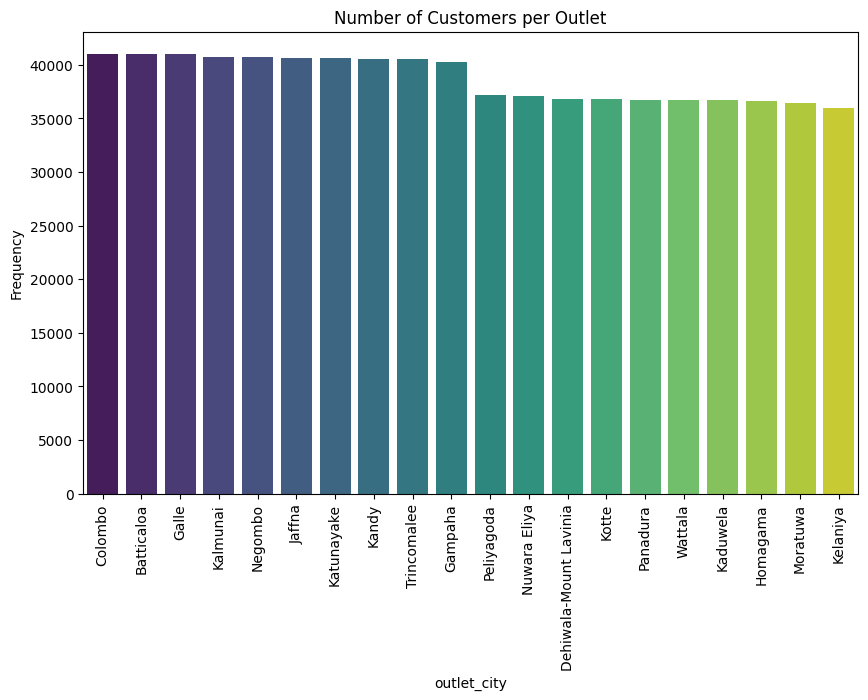

In [44]:
plt.figure(figsize=(10, 6))
sns.countplot(x=data['outlet_city'], order=data['outlet_city'].value_counts().index, palette='viridis')
plt.xlabel('outlet_city')
plt.ylabel('Frequency')
plt.xticks(rotation=90)
plt.title("Number of Customers per Outlet")
plt.show()

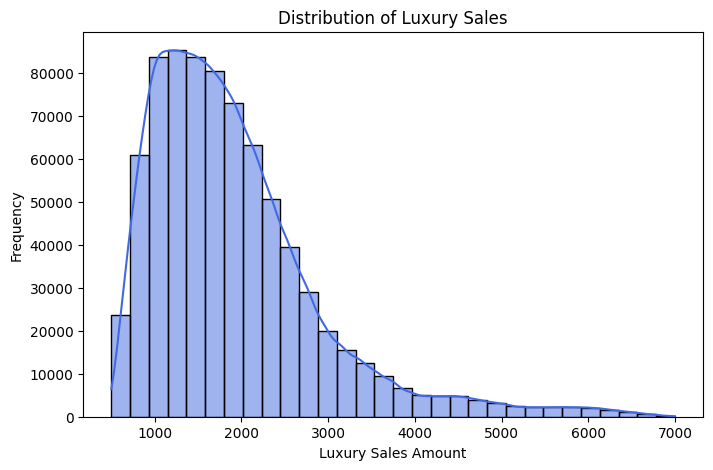

In [45]:
plt.figure(figsize=(8, 5))
sns.histplot(data['luxury_sales'], bins=30, kde=True, color='royalblue')
plt.title("Distribution of Luxury Sales")
plt.xlabel("Luxury Sales Amount")
plt.ylabel("Frequency")
plt.show()

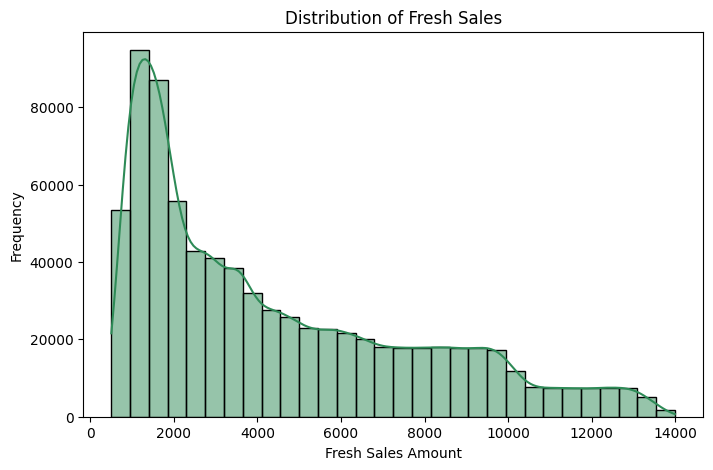

In [46]:
plt.figure(figsize=(8, 5))
sns.histplot(data['fresh_sales'], bins=30, kde=True, color='seagreen')
plt.title("Distribution of Fresh Sales")
plt.xlabel("Fresh Sales Amount")
plt.ylabel("Frequency")
plt.show()

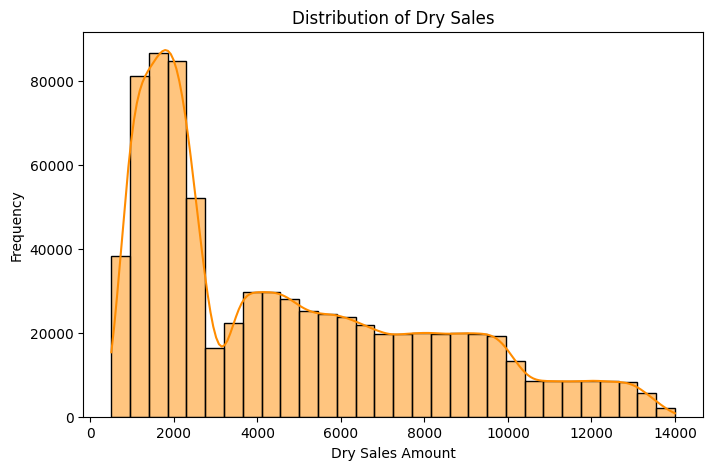

In [47]:
plt.figure(figsize=(8, 5))
sns.histplot(data['dry_sales'], bins=30, kde=True, color='darkorange')
plt.title("Distribution of Dry Sales")
plt.xlabel("Dry Sales Amount")
plt.ylabel("Frequency")
plt.show()

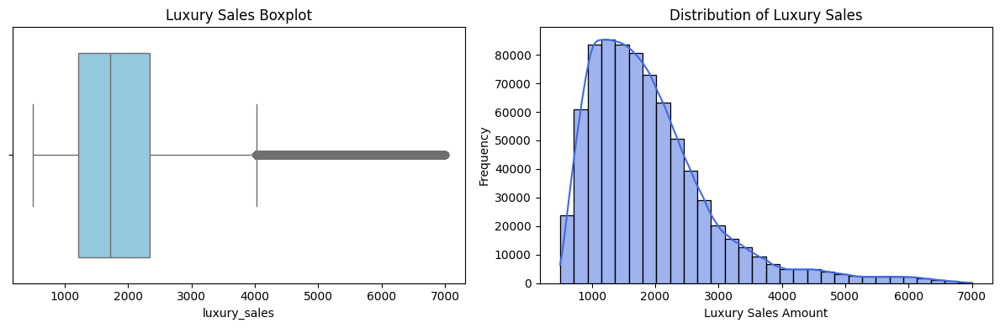

In [48]:
plt.figure(figsize=(12, 4))

# Boxplot
plt.subplot(1, 2, 1)
sns.boxplot(x=data['luxury_sales'], color='skyblue')
plt.title('Luxury Sales Boxplot')

# Distribution Plot
plt.subplot(1, 2, 2)
sns.histplot(data['luxury_sales'], bins=30, kde=True, color='royalblue', edgecolor='black')
plt.title('Distribution of Luxury Sales')
plt.xlabel('Luxury Sales Amount')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

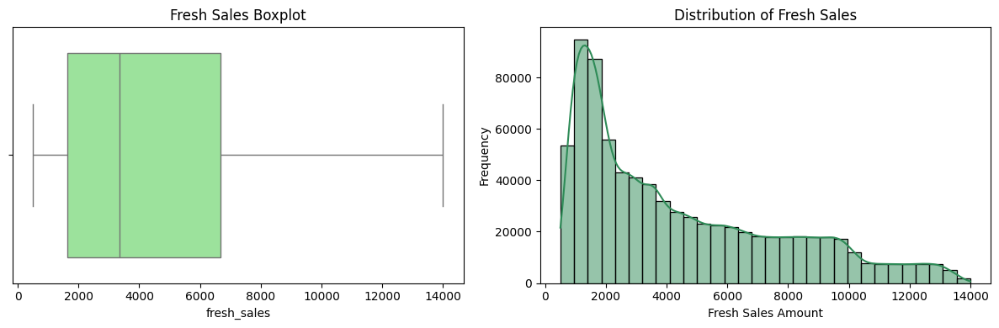

In [49]:
plt.figure(figsize=(12, 4))

# Boxplot
plt.subplot(1, 2, 1)
sns.boxplot(x=data['fresh_sales'], color='lightgreen')
plt.title('Fresh Sales Boxplot')

# Distribution Plot
plt.subplot(1, 2, 2)
sns.histplot(data['fresh_sales'], bins=30, kde=True, color='seagreen', edgecolor='black')
plt.title('Distribution of Fresh Sales')
plt.xlabel('Fresh Sales Amount')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

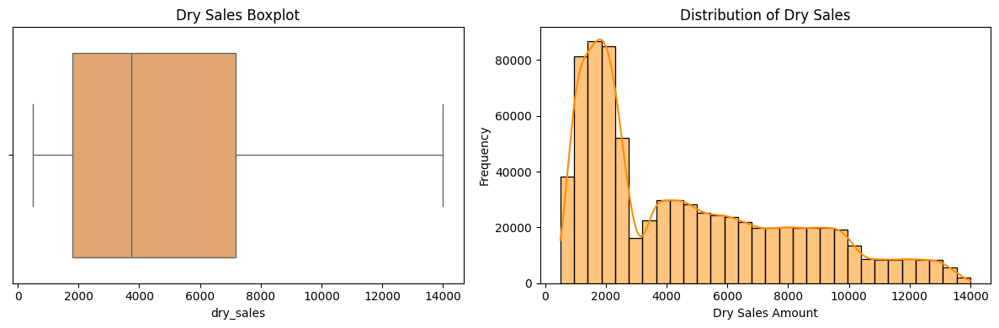

In [50]:
plt.figure(figsize=(12, 4))

# Boxplot
plt.subplot(1, 2, 1)
sns.boxplot(x=data['dry_sales'], color='sandybrown')
plt.title('Dry Sales Boxplot')

# Distribution Plot
plt.subplot(1, 2, 2)
sns.histplot(data['dry_sales'], bins=30, kde=True, color='darkorange', edgecolor='black')
plt.title('Distribution of Dry Sales')
plt.xlabel('Dry Sales Amount')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

Bivariate Analysis

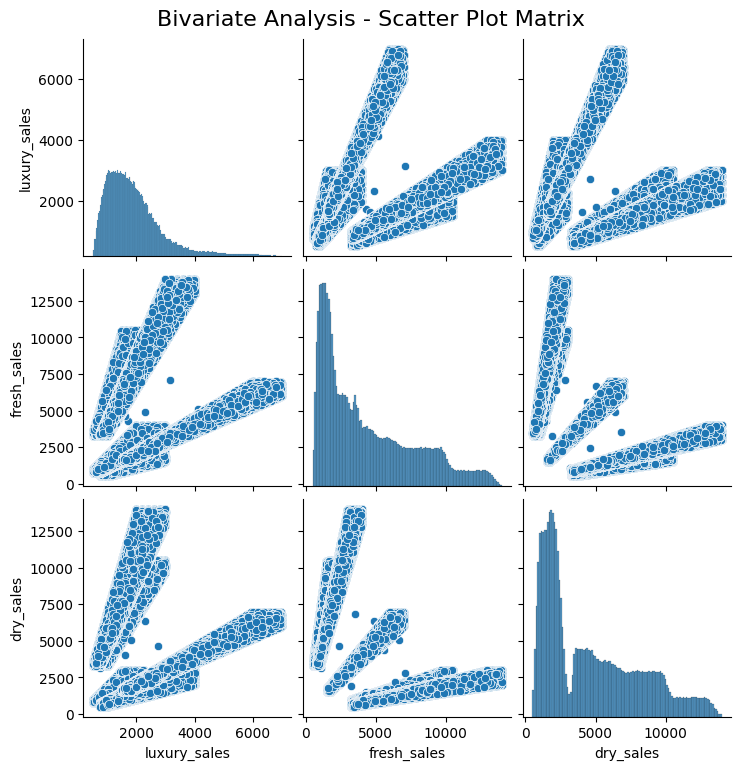

In [51]:
# Pairplot for scatter plot matrix
sns.pairplot(data[['luxury_sales', 'fresh_sales', 'dry_sales']])
plt.suptitle('Bivariate Analysis - Scatter Plot Matrix', fontsize=16, y=1.02)
plt.show()

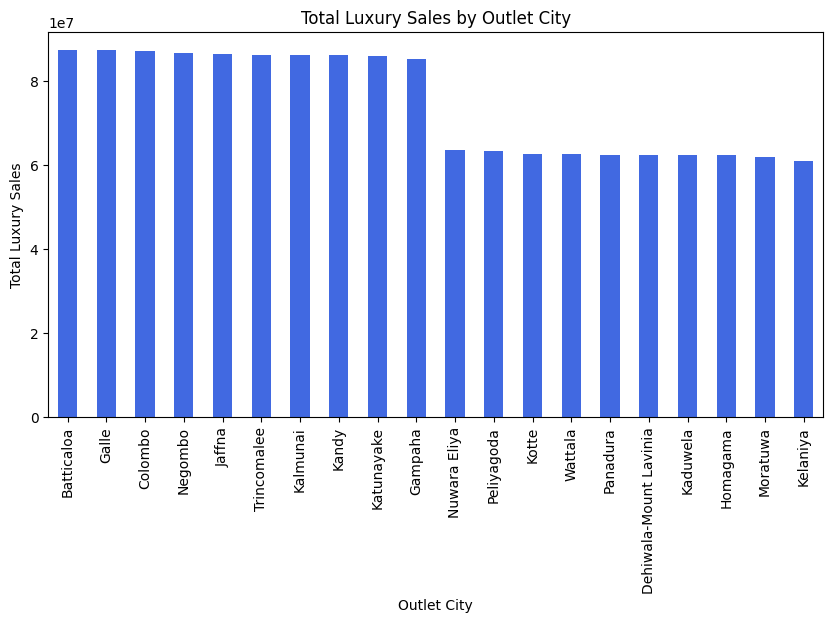

In [52]:
plt.figure(figsize=(10, 5))
city_sales = data.groupby("outlet_city")["luxury_sales"].sum().sort_values(ascending=False)
city_sales.plot(kind='bar', color='royalblue')

plt.title("Total Luxury Sales by Outlet City")
plt.xlabel("Outlet City")
plt.ylabel("Total Luxury Sales")
plt.xticks(rotation=90)
plt.show()

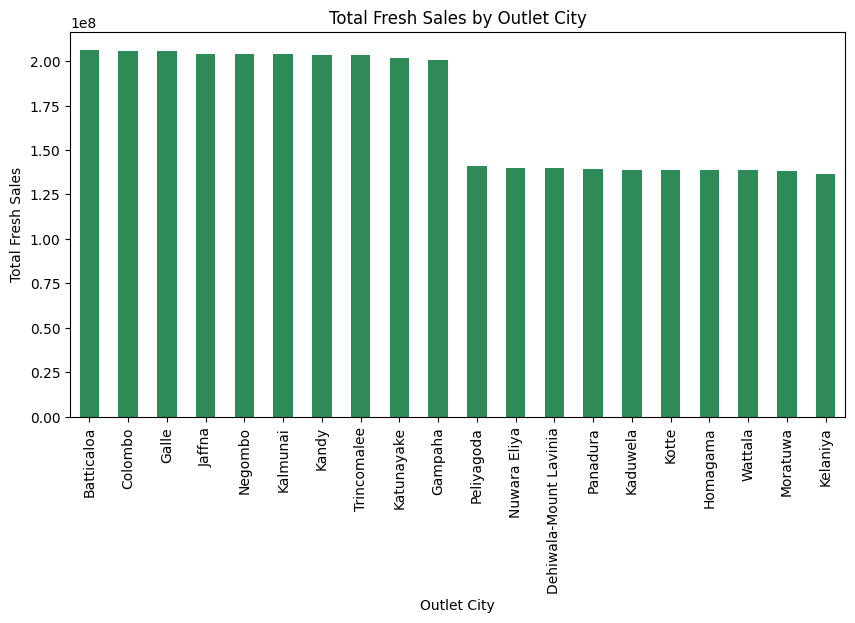

In [53]:
plt.figure(figsize=(10, 5))
city_sales = data.groupby("outlet_city")["fresh_sales"].sum().sort_values(ascending=False)
city_sales.plot(kind='bar', color='seagreen')

plt.title("Total Fresh Sales by Outlet City")
plt.xlabel("Outlet City")
plt.ylabel("Total Fresh Sales")
plt.xticks(rotation=90)
plt.show()

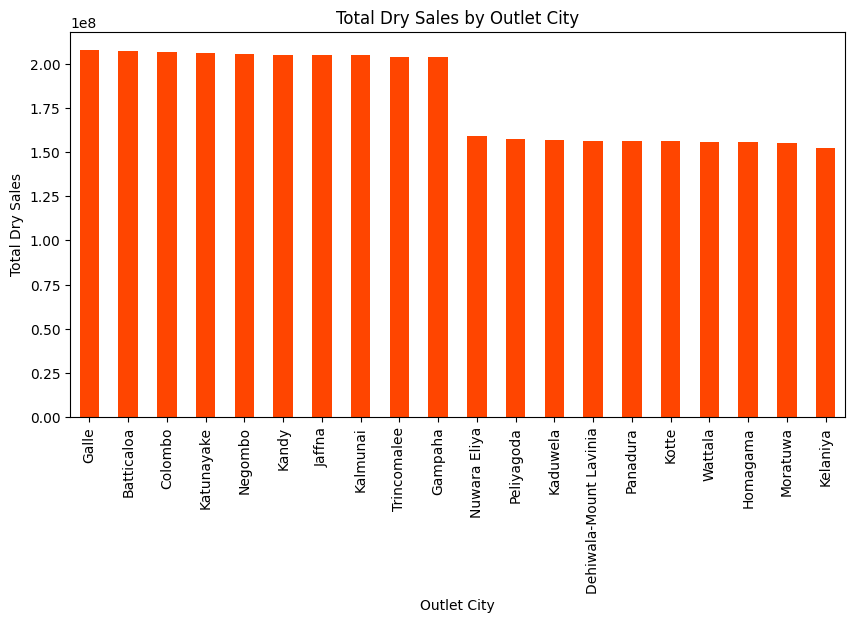

In [54]:
plt.figure(figsize=(10, 5))
city_sales = data.groupby("outlet_city")["dry_sales"].sum().sort_values(ascending=False)
city_sales.plot(kind='bar', color='orangered')

plt.title("Total Dry Sales by Outlet City")
plt.xlabel("Outlet City")
plt.ylabel("Total Dry Sales")
plt.xticks(rotation=90)
plt.show()

In [55]:
num_cols = ['luxury_sales', 'fresh_sales', 'dry_sales']

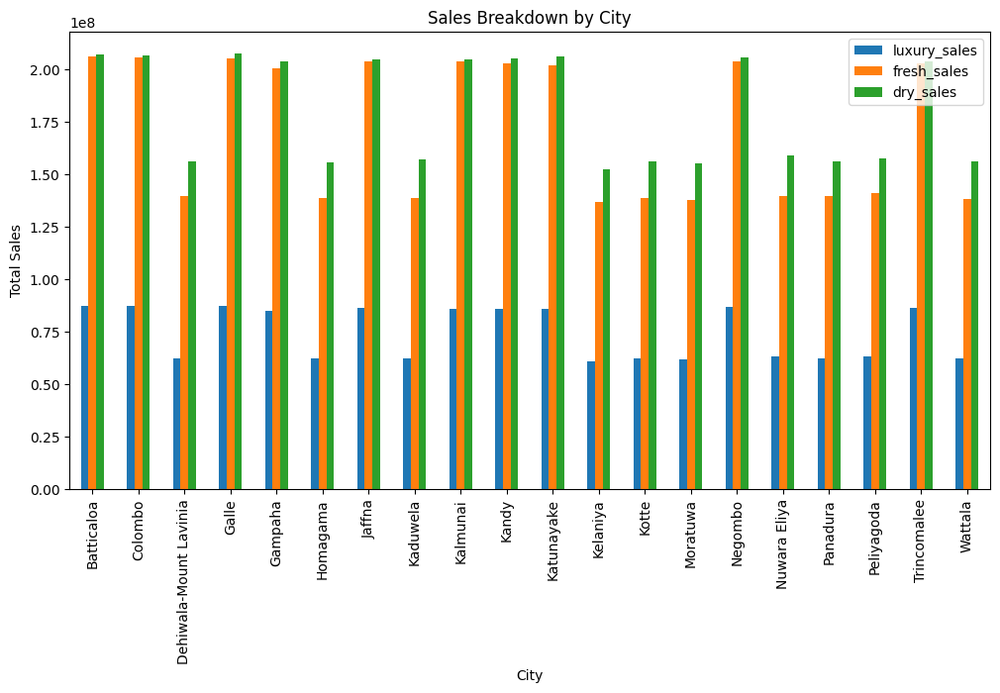

In [56]:
city_sales = data.groupby("outlet_city")[num_cols].sum()

city_sales.plot(kind='bar', figsize=(12, 6))
plt.title("Sales Breakdown by City")
plt.xlabel("City")
plt.ylabel("Total Sales")
plt.xticks(rotation=90)
plt.show()

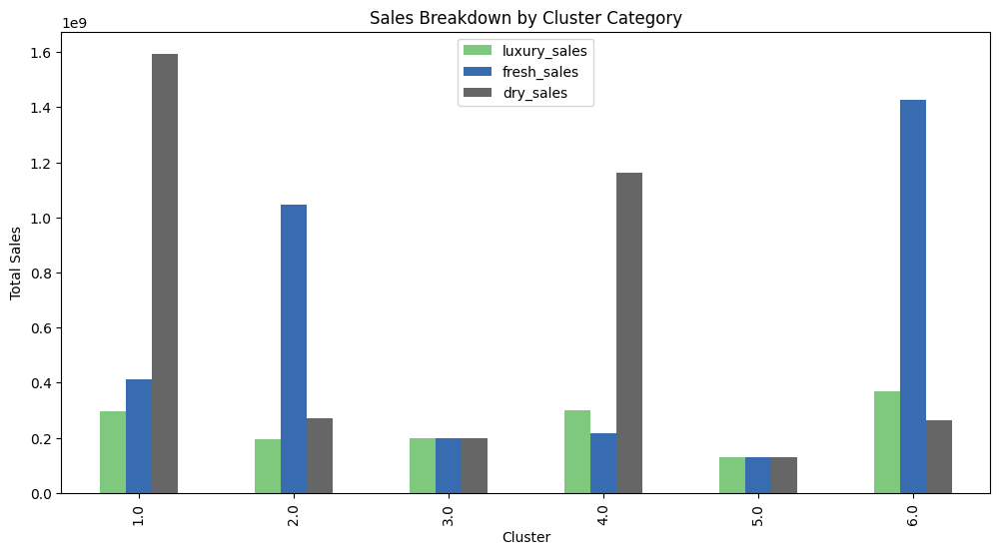

In [57]:
city_sales = data.groupby("cluster_catgeory")[num_cols].sum()

city_sales.plot(kind='bar', figsize=(12, 6), colormap='Accent')
plt.title("Sales Breakdown by Cluster Category")
plt.xlabel("Cluster")
plt.ylabel("Total Sales")
plt.xticks(rotation=90)
plt.show()

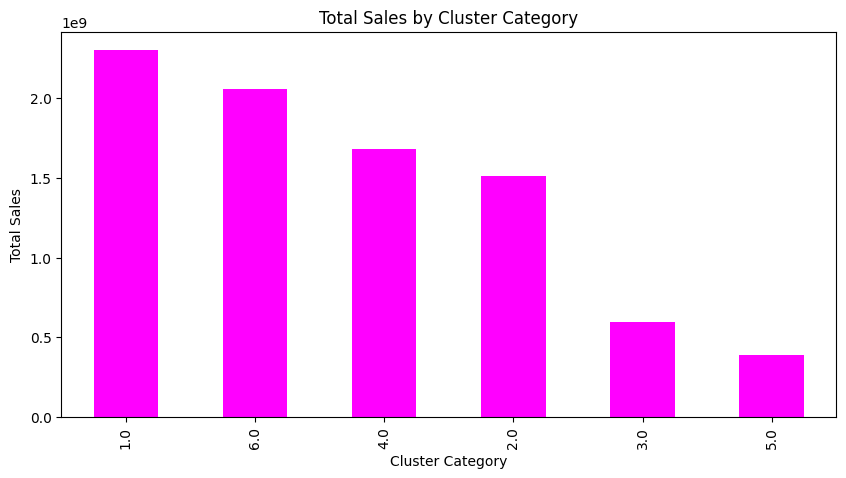

In [58]:
plt.figure(figsize=(10, 5))
city_sales = data.groupby("cluster_catgeory")["total_sales"].sum().sort_values(ascending=False)
city_sales.plot(kind='bar', color='magenta')

plt.title("Total Sales by Cluster Category")
plt.xlabel("Cluster Category")
plt.ylabel("Total Sales")
plt.xticks(rotation=90)
plt.show()

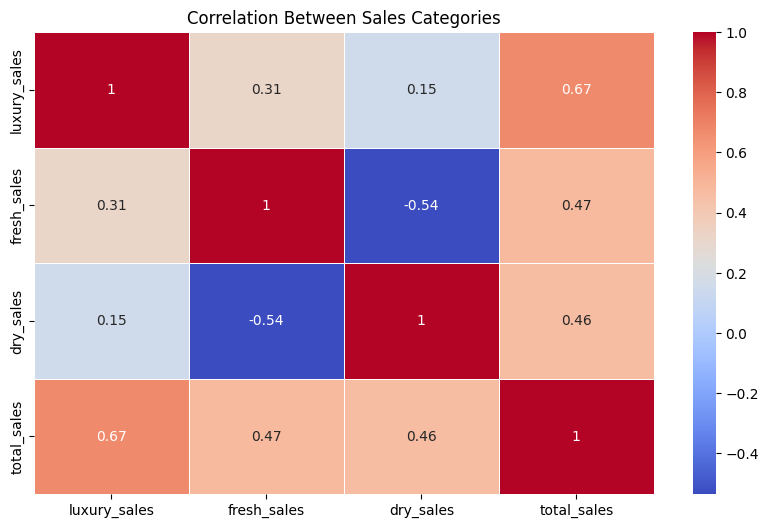

In [59]:
plt.figure(figsize=(10, 6))
sns.heatmap(data[['luxury_sales', 'fresh_sales', 'dry_sales', 'total_sales']].corr(), annot=True, cmap='coolwarm', linewidths=0.5)
plt.title("Correlation Between Sales Categories")
plt.show()

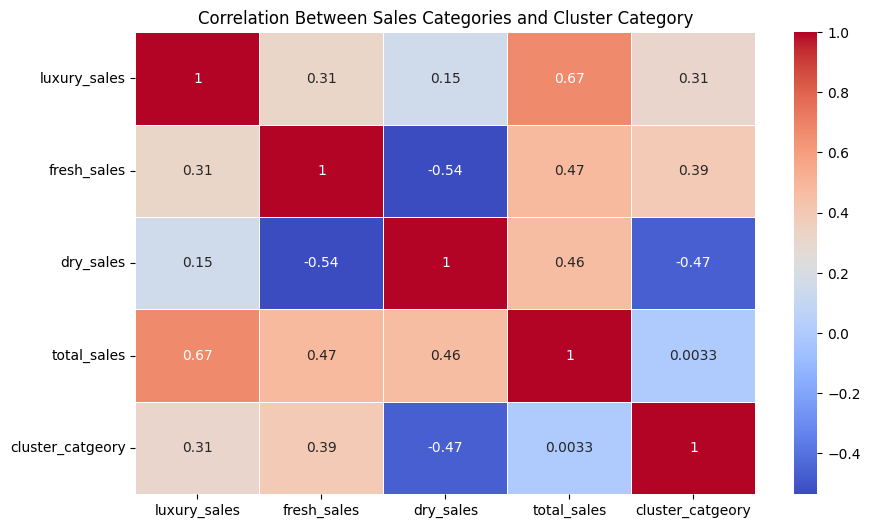

In [60]:
plt.figure(figsize=(10, 6))
sns.heatmap(data[['luxury_sales', 'fresh_sales', 'dry_sales', 'total_sales', 'cluster_catgeory']].corr(), annot=True, cmap='coolwarm', linewidths=0.5)
plt.title("Correlation Between Sales Categories and Cluster Category")
plt.show()

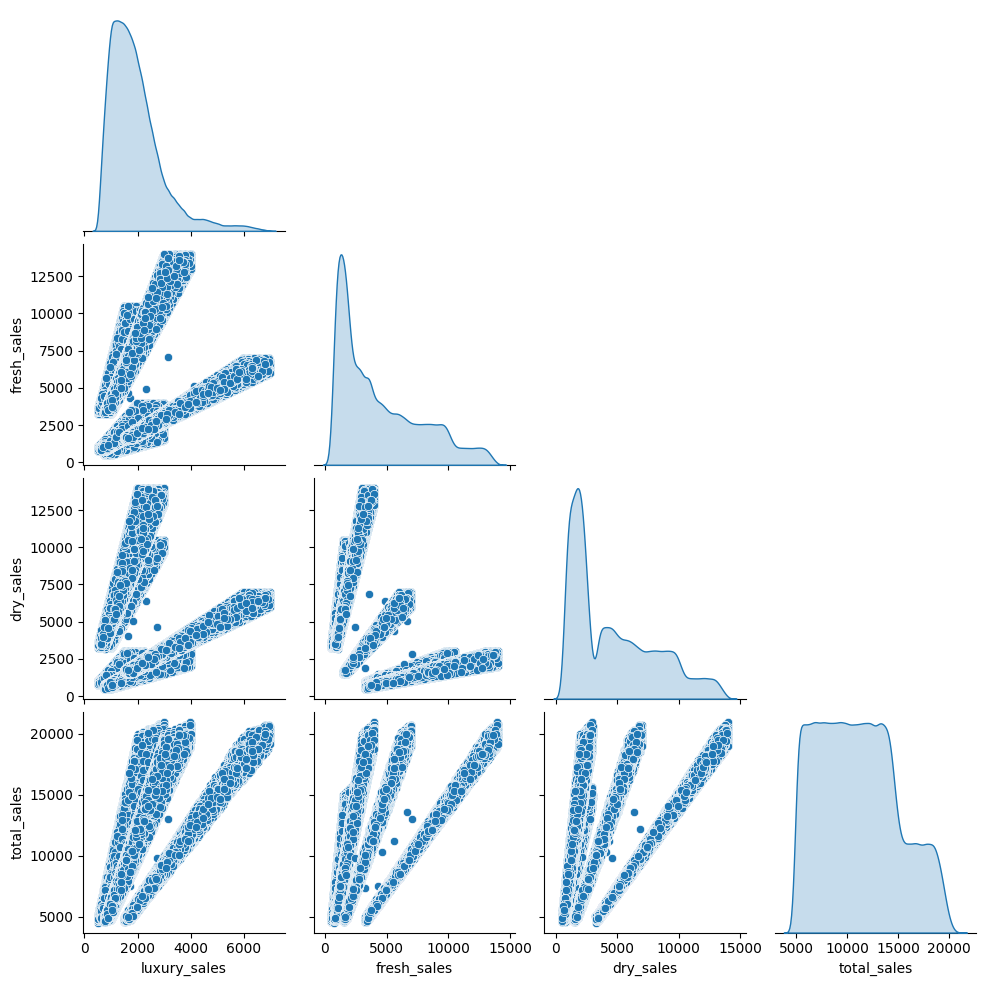

In [61]:
sns.pairplot(data[num_cols + ['total_sales']], diag_kind='kde', corner=True)
plt.show()

In [62]:
data.to_csv('cleaned_data.csv', index=False)